In [15]:
#importing necessary libraries
import warnings
import pandas as pd 
import numpy as np
import statsmodels.api as sm
import statsmodels
import pandas_profiling

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import seaborn as sns 

warnings.filterwarnings('ignore')

In [13]:
df = pd.read_csv("../Data/kc_house_data.csv")

In [14]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,...,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,...,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


In [20]:
df.shape

(21597, 21)

In [21]:
df['view'].unique()

array([ 0., nan,  3.,  4.,  2.,  1.])

In [22]:
df = df.drop(['id'], axis=1)

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           21597 non-null  object 
 1   price          21597 non-null  float64
 2   bedrooms       21597 non-null  int64  
 3   bathrooms      21597 non-null  float64
 4   sqft_living    21597 non-null  int64  
 5   sqft_lot       21597 non-null  int64  
 6   floors         21597 non-null  float64
 7   waterfront     19221 non-null  float64
 8   view           21534 non-null  float64
 9   condition      21597 non-null  int64  
 10  grade          21597 non-null  int64  
 11  sqft_above     21597 non-null  int64  
 12  sqft_basement  21597 non-null  object 
 13  yr_built       21597 non-null  int64  
 14  yr_renovated   17755 non-null  float64
 15  zipcode        21597 non-null  int64  
 16  lat            21597 non-null  float64
 17  long           21597 non-null  float64
 18  sqft_l

In [24]:
df['waterfront'].value_counts()

0.0    19075
1.0      146
Name: waterfront, dtype: int64

In [25]:
df['bedrooms'].max()

33

In [26]:
df['sqft_basement'] = df['sqft_basement'].apply(lambda x: x.replace('?', '0'))
df['sqft_basement'] = df['sqft_basement'].astype('float')

In [27]:
df['has_basement'] = df['sqft_basement'].apply(lambda x: 1 if x>0 else 0)
df.drop('sqft_basement', axis=1, inplace=True)

In [29]:
feature_names = ['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
                 'condition', 'grade', 'sqft_above', 'yr_built',
                 'yr_renovated', 'sqft_living15', 'sqft_lot15', 'sqft_basement']

In [32]:
df['date'] =  pd.to_datetime(df['date'], infer_datetime_format=True)

In [33]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,has_basement
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,1955,0.0,98178,47.5112,-122.257,1340,5650,0
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,1951,1991.0,98125,47.7210,-122.319,1690,7639,1
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,1933,NaN,98028,47.7379,-122.233,2720,8062,0
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,7,1050,1965,0.0,98136,47.5208,-122.393,1360,5000,1
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,1680,1987,0.0,98074,47.6168,-122.045,1800,7503,0


In [34]:
df['year'] = df['date'].dt.year

In [35]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,has_basement,year
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,...,1180,1955,0.0,98178,47.5112,-122.257,1340,5650,0,2014
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,...,2170,1951,1991.0,98125,47.7210,-122.319,1690,7639,1,2014
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,...,770,1933,NaN,98028,47.7379,-122.233,2720,8062,0,2015
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,...,1050,1965,0.0,98136,47.5208,-122.393,1360,5000,1,2014
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,...,1680,1987,0.0,98074,47.6168,-122.045,1800,7503,0,2015


In [36]:
df['age_when_sold'] = df['year'] - df['yr_built']

In [37]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,has_basement,year,age_when_sold
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,...,1955,0.0,98178,47.5112,-122.257,1340,5650,0,2014,59
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,...,1951,1991.0,98125,47.7210,-122.319,1690,7639,1,2014,63
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,...,1933,NaN,98028,47.7379,-122.233,2720,8062,0,2015,82
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,...,1965,0.0,98136,47.5208,-122.393,1360,5000,1,2014,49
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,...,1987,0.0,98074,47.6168,-122.045,1800,7503,0,2015,28


In [38]:
df['yr_renovated'] = df['yr_renovated'].isna().sum()

In [39]:
df['yr_renovated'].shape

(21597,)

In [40]:
df['yr_renovated'].unique()

array([3842], dtype=int64)

In [41]:
df['yr_renovated'].isna().sum()

0

In [42]:
df['zipcode'].unique()

array([98178, 98125, 98028, 98136, 98074, 98053, 98003, 98198, 98146,
       98038, 98007, 98115, 98107, 98126, 98019, 98103, 98002, 98133,
       98040, 98092, 98030, 98119, 98112, 98052, 98027, 98117, 98058,
       98001, 98056, 98166, 98023, 98070, 98148, 98105, 98042, 98008,
       98059, 98122, 98144, 98004, 98005, 98034, 98075, 98116, 98010,
       98118, 98199, 98032, 98045, 98102, 98077, 98108, 98168, 98177,
       98065, 98029, 98006, 98109, 98022, 98033, 98155, 98024, 98011,
       98031, 98106, 98072, 98188, 98014, 98055, 98039], dtype=int64)

In [43]:
df['date'].describe()

count                   21597
unique                    372
top       2014-06-23 00:00:00
freq                      142
first     2014-05-02 00:00:00
last      2015-05-27 00:00:00
Name: date, dtype: object

In [44]:
# df['bathrooms'] = np.round(2*df['bathrooms'],0)/2

In [45]:
df['waterfront'].isna().sum()

2376

In [46]:
df['waterfront'] = df['waterfront'].fillna(0)

In [47]:
df['waterfront'] = df['waterfront'].astype(int)

In [48]:
df.drop('view', axis=1, inplace=True)

In [ ]:
# !pip install --user pandas-profiling

In [16]:
pandas_profiling.ProfileReport(df)

In [49]:
df["month"] = df.date.dt.month

In [50]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,has_basement,year,age_when_sold,month
0,2014-10-13,221900.0,3,1.0,1180,5650,1.0,0,3,7,...,3842,98178,47.5112,-122.257,1340,5650,0,2014,59,10
1,2014-12-09,538000.0,3,2.0,2570,7242,2.0,0,3,7,...,3842,98125,47.7210,-122.319,1690,7639,1,2014,63,12
2,2015-02-25,180000.0,2,1.0,770,10000,1.0,0,3,6,...,3842,98028,47.7379,-122.233,2720,8062,0,2015,82,2
3,2014-12-09,604000.0,4,3.0,1960,5000,1.0,0,5,7,...,3842,98136,47.5208,-122.393,1360,5000,1,2014,49,12
4,2015-02-18,510000.0,3,2.0,1680,8080,1.0,0,3,8,...,3842,98074,47.6168,-122.045,1800,7503,0,2015,28,2


In [52]:
df['floors'].unique()

array([1. , 2. , 1.5, 3. , 2.5, 3.5])

In [59]:
df['month'] = df['date'].dt.strftime('%B')

In [57]:
df.drop(['Month'], axis=1, inplace=True)

In [60]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,has_basement,year,age_when_sold,month
0,2014-10-13,221900.0,3,1.0,1180,5650,1.0,0,3,7,...,3842,98178,47.5112,-122.257,1340,5650,0,2014,59,October
1,2014-12-09,538000.0,3,2.0,2570,7242,2.0,0,3,7,...,3842,98125,47.7210,-122.319,1690,7639,1,2014,63,December
2,2015-02-25,180000.0,2,1.0,770,10000,1.0,0,3,6,...,3842,98028,47.7379,-122.233,2720,8062,0,2015,82,February
3,2014-12-09,604000.0,4,3.0,1960,5000,1.0,0,5,7,...,3842,98136,47.5208,-122.393,1360,5000,1,2014,49,December
4,2015-02-18,510000.0,3,2.0,1680,8080,1.0,0,3,8,...,3842,98074,47.6168,-122.045,1800,7503,0,2015,28,February


In [28]:
df.to_csv("cleaned_data.csv", index=False)

In [56]:
df = pd.read_csv("master_df.csv")

In [57]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,zipcode,lat,long,sqft_living15,sqft_lot15,basement,year,Renovated,age_when_sold,month
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,98178,47.5112,-122.257,1340,5650,0,2014,0,59,10
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,98125,47.7210,-122.319,1690,7639,1,2014,1,63,12
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,...,98028,47.7379,-122.233,2720,8062,0,2015,0,82,2
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,98136,47.5208,-122.393,1360,5000,1,2014,0,49,12
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,98074,47.6168,-122.045,1800,7503,0,2015,0,28,2


In [58]:
df.drop(df.loc[df['bedrooms']==33].index, inplace=True)

In [59]:
df.drop(df.loc[df['grade']==13].index, inplace=True)

In [60]:
df.drop(df.loc[df['waterfront']==1].index, inplace=True)

In [61]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,zipcode,lat,long,sqft_living15,sqft_lot15,basement,year,Renovated,age_when_sold,month
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,98178,47.5112,-122.257,1340,5650,0,2014,0,59,10
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,98125,47.7210,-122.319,1690,7639,1,2014,1,63,12
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,...,98028,47.7379,-122.233,2720,8062,0,2015,0,82,2
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,98136,47.5208,-122.393,1360,5000,1,2014,0,49,12
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,98074,47.6168,-122.045,1800,7503,0,2015,0,28,2


In [62]:
df.loc[df['age_when_sold']==-1]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,zipcode,lat,long,sqft_living15,sqft_lot15,basement,year,Renovated,age_when_sold,month
1761,2014-06-25,597326.0,4,4.00,3570,8250,2.0,0,0,3,...,98040,47.5784,-122.226,2230,10000,1,2014,0,-1,6
2685,2014-10-29,385195.0,1,1.00,710,6000,1.5,0,0,3,...,98144,47.5756,-122.316,1440,4800,0,2014,0,-1,10
7519,2014-12-31,614285.0,5,2.75,2730,6401,2.0,0,0,3,...,98072,47.7685,-122.160,2520,6126,0,2014,0,-1,12
8032,2014-06-24,455000.0,2,1.50,1200,1259,2.0,0,0,3,...,98144,47.6001,-122.298,1320,1852,1,2014,0,-1,6
14475,2014-08-26,500000.0,2,2.25,1570,1269,2.0,0,0,3,...,98199,47.6514,-122.385,1570,6000,1,2014,0,-1,8
17084,2014-06-17,350000.0,3,2.00,1380,3600,3.0,0,0,3,...,98122,47.6074,-122.305,1480,3600,0,2014,0,-1,6
19789,2014-08-01,455000.0,3,1.75,1320,1014,3.0,0,0,3,...,98122,47.6047,-122.305,1380,1495,0,2014,0,-1,8
20754,2014-08-28,357000.0,5,2.50,2990,9240,2.0,0,0,3,...,98133,47.7384,-122.348,1970,18110,0,2014,0,-1,8
20836,2014-07-09,595000.0,4,3.25,3730,4560,2.0,0,0,3,...,98103,47.6725,-122.330,1800,4560,1,2014,0,-1,7
20947,2014-07-31,230000.0,3,1.50,1040,1264,2.0,0,0,3,...,98144,47.5951,-122.301,1350,3000,1,2014,0,-1,7


In [63]:
df = df.loc[df['price'] <= 3500000]

In [65]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21430 entries, 0 to 21596
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           21430 non-null  object 
 1   price          21430 non-null  float64
 2   bedrooms       21430 non-null  int64  
 3   bathrooms      21430 non-null  float64
 4   sqft_living    21430 non-null  int64  
 5   sqft_lot       21430 non-null  int64  
 6   floors         21430 non-null  float64
 7   waterfront     21430 non-null  int64  
 8   view           21430 non-null  int64  
 9   condition      21430 non-null  int64  
 10  grade          21430 non-null  int64  
 11  sqft_above     21430 non-null  int64  
 12  sqft_basement  21430 non-null  float64
 13  yr_built       21430 non-null  int64  
 14  yr_renovated   21430 non-null  int64  
 15  zipcode        21430 non-null  int64  
 16  lat            21430 non-null  float64
 17  long           21430 non-null  float64
 18  sqft_l

In [79]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)

In [78]:
X = df
X.drop(columns = 'price')

,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,zipcode,lat,long,sqft_living15,sqft_lot15,basement,year,Renovated,age_when_sold,month
0,2014-10-13,3,1.00,1180,5650,1.0,0,0,3,7,...,98178,47.5112,-122.257,1340,5650,0,2014,0,59,10
1,2014-12-09,3,2.25,2570,7242,2.0,0,0,3,7,...,98125,47.7210,-122.319,1690,7639,1,2014,1,63,12
2,2015-02-25,2,1.00,770,10000,1.0,0,0,3,6,...,98028,47.7379,-122.233,2720,8062,0,2015,0,82,2
3,2014-12-09,4,3.00,1960,5000,1.0,0,0,5,7,...,98136,47.5208,-122.393,1360,5000,1,2014,0,49,12
4,2015-02-18,3,2.00,1680,8080,1.0,0,0,3,8,...,98074,47.6168,-122.045,1800,7503,0,2015,0,28,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,2014-05-21,3,2.50,1530,1131,3.0,0,0,3,8,...,98103,47.6993,-122.346,1530,1509,0,2014,0,5,5
21593,2015-02-23,4,2.50,2310,5813,2.0,0,0,3,8,...,98146,47.5107,-122.362,1830,7200,0,2015,0,1,2
21594,2014-06-23,2,0.75,1020,1350,2.0,0,0,3,7,...,98144,47.5944,-122.299,1020,2007,0,2014,0,5,6
21595,2015-01-16,3,2.50,1600,2388,2.0,0,0,3,8,...,98027,47.5345,-122.069,1410,1287,0,2015,0,11,1


In [84]:
# function to use in linear regression model notebook
def make_ols_sklearn(X, y, test_size=0.20, fit_intercept=False, standardize=False):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size)
    if standardize:
        ss = StandardScaler()
        ss.fit(X_train)
        X_train = ss.transform(X_train)
        X_test = ss.transform(X_test)
    ols = LinearRegression(fit_intercept=fit_intercept, normalize=False)
    ols.fit(X_train, y_train)
    train_score = ols.score(X._train, y_train)
    test_score = ols.score(X_test, y_test)
    print(f"train score = {train_score}")
    print(f"test score = {test_score}")
    return ols
       


## Transform Categorical Variables

In [4]:
df = pd.read_csv("master_df.csv")

In [6]:
df.columns

Index(['date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'basement', 'year', 'Renovated',
       'age_when_sold', 'month'],
      dtype='object')

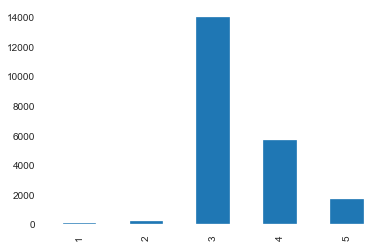

In [12]:
df.condition.value_counts().sort_index().plot(kind = "bar")

In [14]:
df.groupby('condition').agg('mean')['price']

condition
1    341067.241379
2    328178.758824
3    542173.057347
4    521374.450414
5    612577.742504
Name: price, dtype: float64

In [15]:
df.groupby('condition').agg('std')['price']

condition
1    273482.773771
2    246987.012476
3    364650.098712
4    358795.961135
5    411317.859815
Name: price, dtype: float64

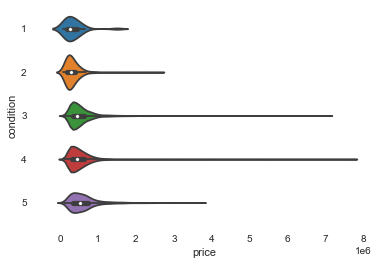

In [16]:
sns.violinplot(x='price', y='condition', data=df, orient='h')
plt.show()

In [17]:
df['condition3'] = df.condition.apply(lambda x: 1 if x >=3 else 0)
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,lat,long,sqft_living15,sqft_lot15,basement,year,Renovated,age_when_sold,month,condition3
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,47.5112,-122.257,1340,5650,0,2014,0,59,10,1
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,47.7210,-122.319,1690,7639,1,2014,1,63,12,1
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,...,47.7379,-122.233,2720,8062,0,2015,0,82,2,1
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,47.5208,-122.393,1360,5000,1,2014,0,49,12,1
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,47.6168,-122.045,1800,7503,0,2015,0,28,2,1


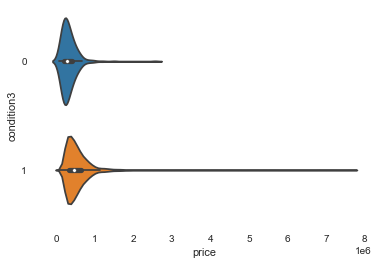

In [18]:
sns.violinplot(x='price', y='condition3', data=df, orient='h')
plt.show()

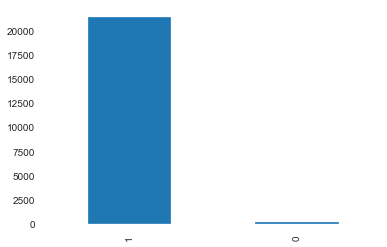

In [20]:
df.condition3.value_counts().plot(kind = 'bar')

In [21]:
res = statsmodels.stats.multicomp.pairwise_tukeyhsd(df['price'], df['condition'])

print(res)

      Multiple Comparison of Means - Tukey HSD, FWER=0.05       
group1 group2   meandiff  p-adj     lower        upper    reject
----------------------------------------------------------------
     1      2 -12888.4826    0.9 -213570.5233 187793.5582  False
     1      3  201105.816  0.026   15430.0899  386781.542   True
     1      4  180307.209 0.0626   -5649.9351 366264.3532  False
     1      5 271510.5011  0.001   84452.0534 458568.9488   True
     2      3 213994.2985  0.001  136922.0267 291066.5703   True
     2      4 193195.6916  0.001  115447.8986 270943.4845   True
     2      5 284398.9837  0.001  204052.7161 364745.2512   True
     3      4 -20798.6069 0.0028   -36512.074  -5085.1399   True
     3      5  70404.6852  0.001   44758.7021  96050.6682   True
     4      5  91203.2921  0.001    63593.499 118813.0852   True
----------------------------------------------------------------


In [22]:
ols = sm.OLS(df['price'], df['condition'])
res = ols.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  price   R-squared (uncentered):                   0.666
Model:                            OLS   Adj. R-squared (uncentered):              0.666
Method:                 Least Squares   F-statistic:                          4.307e+04
Date:                Tue, 02 Jun 2020   Prob (F-statistic):                        0.00
Time:                        14:51:13   Log-Likelihood:                     -3.0798e+05
No. Observations:               21597   AIC:                                  6.160e+05
Df Residuals:                   21596   BIC:                                  6.160e+05
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
condition   1.536e+05    740.156    207.528      0.000    1.52e+05    1.55e+05
==============================================================================
Omnibus:                    17895.587   Durbin-Watson:                   1.954
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           916710.041
Skew:                           3.665   Prob(JB):                         0.00
Kurtosis:                      34.064   Cond. No.                         1.00
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [23]:
df_cat = pd.get_dummies(df, columns=['condition'], drop_first=True)
df_cat

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,grade,...,basement,year,Renovated,age_when_sold,month,condition3,condition_2,condition_3,condition_4,condition_5
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,7,...,0,2014,0,59,10,1,0,1,0,0
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,7,...,1,2014,1,63,12,1,0,1,0,0
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,6,...,0,2015,0,82,2,1,0,1,0,0
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,7,...,1,2014,0,49,12,1,0,0,0,1
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,8,...,0,2015,0,28,2,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,2014-05-21,360000.0,3,2.50,1530,1131,3.0,0,0,8,...,0,2014,0,5,5,1,0,1,0,0
21593,2015-02-23,400000.0,4,2.50,2310,5813,2.0,0,0,8,...,0,2015,0,1,2,1,0,1,0,0
21594,2014-06-23,402101.0,2,0.75,1020,1350,2.0,0,0,7,...,0,2014,0,5,6,1,0,1,0,0
21595,2015-01-16,400000.0,3,2.50,1600,2388,2.0,0,0,8,...,0,2015,0,11,1,1,0,1,0,0


In [24]:
condition_cols = [col for col in df_cat.columns if 'condition_' in col]
condition_cols

['condition_2', 'condition_3', 'condition_4', 'condition_5']

In [25]:
X = df_cat[condition_cols]
y = df_cat['price']

In [26]:
ols = sm.OLS(y, X)
res = ols.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  price   R-squared (uncentered):                   0.686
Model:                            OLS   Adj. R-squared (uncentered):              0.686
Method:                 Least Squares   F-statistic:                          1.177e+04
Date:                Tue, 02 Jun 2020   Prob (F-statistic):                        0.00
Time:                        14:52:46   Log-Likelihood:                     -3.0733e+05
No. Observations:               21597   AIC:                                  6.147e+05
Df Residuals:                   21593   BIC:                                  6.147e+05
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
condition_2  3.282e+05   2.81e+04     11.680      0.000    2.73e+05    3.83e+05
condition_3  5.422e+05   3094.088    175.229      0.000    5.36e+05    5.48e+05
condition_4  5.214e+05   4862.361    107.227      0.000    5.12e+05    5.31e+05
condition_5  6.126e+05   8882.895     68.961      0.000    5.95e+05     6.3e+05
==============================================================================
Omnibus:                    19158.309   Durbin-Watson:                   1.970
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1154384.314
Skew:                           4.036   Prob(JB):                         0.00
Kurtosis:                      37.895   Cond. No.                         9.08
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [29]:
res = statsmodels.stats.multicomp.pairwise_tukeyhsd(df['price'], df['grade'])
print(res)

       Multiple Comparison of Means - Tukey HSD, FWER=0.05        
group1 group2   meandiff   p-adj     lower        upper     reject
------------------------------------------------------------------
     3      4  -49998.1481    0.9 -884565.7697  784569.4734  False
     3      5  -13476.0289    0.9 -834696.6607  807744.6028  False
     3      6   39916.5707    0.9 -779813.6021  859646.7434  False
     3      7  140594.5728    0.9 -678980.2226  960169.3681  False
     3      8     280986.8    0.9 -538609.8947 1100583.4947  False
     3      9  511738.2222 0.6224 -307947.5959 1331424.0403  False
     3     10  810347.4674 0.0561   -9542.9328 1630237.8675  False
     3     11 1235792.3784  0.001  415236.9069   2056347.85   True
     3     12 1940528.0899  0.001  1116407.719 2764648.4608   True
     3     13 3448769.2308  0.001 2598303.6546 4299234.8069   True
     4      5   36522.1192    0.9  -129762.076  202806.3144  False
     4      6   89914.7188 0.7384  -68845.0486  248674.4862  F

In [30]:
df_grade = pd.get_dummies(df, columns=['grade'], drop_first=True)
df_grade

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,grade_4,grade_5,grade_6,grade_7,grade_8,grade_9,grade_10,grade_11,grade_12,grade_13
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,0,0,0,1,0,0,0,0,0,0
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,0,0,0,1,0,0,0,0,0,0
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,...,0,0,1,0,0,0,0,0,0,0
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,0,0,0,1,0,0,0,0,0,0
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,2014-05-21,360000.0,3,2.50,1530,1131,3.0,0,0,3,...,0,0,0,0,1,0,0,0,0,0
21593,2015-02-23,400000.0,4,2.50,2310,5813,2.0,0,0,3,...,0,0,0,0,1,0,0,0,0,0
21594,2014-06-23,402101.0,2,0.75,1020,1350,2.0,0,0,3,...,0,0,0,1,0,0,0,0,0,0
21595,2015-01-16,400000.0,3,2.50,1600,2388,2.0,0,0,3,...,0,0,0,0,1,0,0,0,0,0


In [31]:
grade_cols = [col for col in df_grade.columns if 'grade_' in col]
grade_cols

['grade_4',
 'grade_5',
 'grade_6',
 'grade_7',
 'grade_8',
 'grade_9',
 'grade_10',
 'grade_11',
 'grade_12',
 'grade_13']

In [32]:
X1 = df_grade[grade_cols]
y1 = df_grade['price']

In [33]:
ols = sm.OLS(y1, X1)
res = ols.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  price   R-squared (uncentered):                   0.848
Model:                            OLS   Adj. R-squared (uncentered):              0.848
Method:                 Least Squares   F-statistic:                          1.207e+04
Date:                Tue, 02 Jun 2020   Prob (F-statistic):                        0.00
Time:                        15:01:58   Log-Likelihood:                     -2.9947e+05
No. Observations:               21597   AIC:                                  5.990e+05
Df Residuals:                   21587   BIC:                                  5.990e+05
Df Model:                          10                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
grade_4      2.12e+05    4.9e+04      4.327      0.000    1.16e+05    3.08e+05
grade_5     2.485e+05   1.64e+04     15.186      0.000    2.16e+05    2.81e+05
grade_6     3.019e+05   5639.402     53.537      0.000    2.91e+05    3.13e+05
grade_7     4.026e+05   2687.460    149.805      0.000    3.97e+05    4.08e+05
grade_8      5.43e+05   3269.036    166.100      0.000    5.37e+05    5.49e+05
grade_9     7.737e+05   4978.509    155.416      0.000    7.64e+05    7.83e+05
grade_10    1.072e+06   7560.118    141.843      0.000    1.06e+06    1.09e+06
grade_11    1.498e+06   1.27e+04    117.518      0.000    1.47e+06    1.52e+06
grade_12    2.203e+06    2.7e+04     81.617      0.000    2.15e+06    2.26e+06
grade_13    3.711e+06   7.06e+04     52.553      0.000    3.57e+06    3.85e+06
==============================================================================
Omnibus:                    15767.715   Durbin-Watson:                   1.982
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           792439.721
Skew:                           2.994   Prob(JB):                         0.00
Kurtosis:                      32.065   Cond. No.                         26.3
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [34]:
df['total_sqft'] = df['sqft_living'] + df['sqft_lot']

In [35]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,long,sqft_living15,sqft_lot15,basement,year,Renovated,age_when_sold,month,condition3,total_sqft
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,-122.257,1340,5650,0,2014,0,59,10,1,6830
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,-122.319,1690,7639,1,2014,1,63,12,1,9812
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,...,-122.233,2720,8062,0,2015,0,82,2,1,10770
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,-122.393,1360,5000,1,2014,0,49,12,1,6960
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,-122.045,1800,7503,0,2015,0,28,2,1,9760


In [38]:
df['floors'].describe()

count    21597.000000
mean         1.494096
std          0.539683
min          1.000000
25%          1.000000
50%          1.500000
75%          2.000000
max          3.500000
Name: floors, dtype: float64